In [1]:
from IPython.display import IFrame
import datetime
print("Notebook was last executed on:", datetime.date.today().strftime("%Y-%b-%d"), "with Python version")
!python --version


Notebook was last executed on: 2025-May-03 with Python version
Python 3.13.0


In [2]:
IFrame('https://cdn.finshots.app/images/2023/07/design-119-shark-tank.jpg', width=1000, height=700)

# Project Objective
This project investigates patterns in startup funding pitches from Shark Tank India across multiple seasons. Using comprehensive pitch-level data, it uncovers the factors that influence funding outcomes, analyzes industry trends, and explores investor behavior.

# Table of Contents
1. Importing Libraries and Setup
2. Importing Dataset
3. Data cleaning
4. Missing Value Percenatge of numerical columns
5. Expolatory Data Analysis
6. Pitch Statistics
7. Presenter Demographics
8. Business Characteristics
9. Financial Analysis
10. Shark Participation and Investment Trends
11. Deal Outcomes and Patterns
12. Conclusions

# Importing Libraries and Setup

In [3]:
!pip install geopandas


[notice] A new release of pip is available: 24.3.1 -> 25.1.1
[notice] To update, run: pip install --upgrade pip


In [4]:
import numpy as np
import pandas as pd
pd.set_option('display.max_columns', None)

import matplotlib.pyplot as plt
import seaborn as sns
from babel.numbers import format_currency
from wordcloud import WordCloud, STOPWORDS
import geopandas as gpd
import plotly.express as px
import plotly.io as pio

# Importing Dataset

In [5]:
df = pd.read_csv("Shark Tank India.csv")
nRow, nCol = df.shape
print(f'\nThere are {nRow} rows and {nCol} columns in the dataset')


There are 634 rows and 80 columns in the dataset


## Data Cleaning

In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 634 entries, 0 to 633
Data columns (total 80 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   Season Number              634 non-null    int64  
 1   Startup Name               634 non-null    object 
 2   Episode Number             634 non-null    int64  
 3   Pitch Number               634 non-null    int64  
 4   Season Start               634 non-null    object 
 5   Season End                 478 non-null    object 
 6   Original Air Date          603 non-null    object 
 7   Episode Title              634 non-null    object 
 8   Anchor                     634 non-null    object 
 9   Industry                   634 non-null    object 
 10  Business Description       634 non-null    object 
 11  Company Website            618 non-null    object 
 12  Started in                 456 non-null    float64
 13  Number of Presenters       634 non-null    int64  

In [7]:
df.describe()

,Season Number,Episode Number,Pitch Number,Started in,Number of Presenters,Male Presenters,Female Presenters,Transgender Presenters,Couple Presenters,Yearly Revenue,Monthly Sales,Gross Margin,Net Margin,EBITDA,SKUs,Original Ask Amount,Original Offered Equity,Valuation Requested,Received Offer,Accepted Offer,Total Deal Amount,Total Deal Equity,Total Deal Debt,Debt Interest,Deal Valuation,Number of Sharks in Deal,Royalty Percentage,Royalty Recouped Amount,Advisory Shares Equity,Namita Investment Amount,Namita Investment Equity,Namita Debt Amount,Vineeta Investment Amount,Vineeta Investment Equity,Vineeta Debt Amount,Anupam Investment Amount,Anupam Investment Equity,Anupam Debt Amount,Aman Investment Amount,Aman Investment Equity,Aman Debt Amount,Peyush Investment Amount,Peyush Investment Equity,Peyush Debt Amount,Ritesh Investment Amount,Ritesh Investment Equity,Ritesh Debt Amount,Amit Investment Amount,Amit Investment Equity,Amit Debt Amount,Guest Investment Amount,Guest Investment Equity,Guest Debt Amount,Namita Present,Vineeta Present,Anupam Present,Aman Present,Peyush Present,Ritesh Present,Amit Present,Guest Present
count,634.000000,634.000000,634.000000,456.000000,634.000000,568.000000,382.000000,3.0,634.000000,343.000000,287.000000,162.000000,93.000000,81.000000,43.000000,634.000000,634.000000,634.000000,634.000000,423.000000,360.000000,360.000000,75.000000,58.000000,359.000000,360.000000,36.000000,36.000000,11.000000,114.000000,114.000000,21.000000,89.000000,89.000000,15.000000,102.000000,102.000000,9.000000,141.000000,141.000000,19.000000,104.000000,104.00000,13.000000,52.000000,52.000000,14.000000,35.000000,35.000000,7.000000,63.000000,63.000000,6.000000,495.0,428.0,548.0,556.0,388.0,138.0,137.0,311.000000
mean,2.500000,24.055205,317.500000,2019.280702,2.000000,1.593310,0.942408,1.0,0.176656,665.909621,76.120251,55.179012,20.559140,12.597531,265.441860,128.724785,3.580331,5299.153323,0.667192,0.851064,73.013649,7.628667,49.946667,10.258621,2479.379763,1.955556,1.569444,106.729167,1.480000,35.630169,3.508172,42.825048,33.565107,3.646326,27.388400,33.307164,4.673245,25.000000,38.678848,3.066061,38.043158,39.162642,5.68201,29.000000,42.278548,2.260394,45.594714,35.268571,4.287046,35.000000,45.693369,4.035135,37.943333,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.131833
std,1.106137,15.102549,183.164316,3.082767,0.796913,0.849374,0.624800,0.0,0.381679,1619.021667,233.310816,20.495388,12.930804,15.323968,923.926592,1190.155243,3.595335,8253.239217,0.471590,0.356447,55.329270,8.818134,34.787344,2.970973,3342.992929,1.123674,1.056631,60.199946,0.862844,22.446143,4.697263,41.373381,21.806716,4.256047,15.170918,22.400433,4.987685,15.051993,33.987022,4.009137,21.038993,53.971928,11.06271,15.209646,26.557992,2.280346,47.238364,26.540778,4.713601,18.257419,45.483364,4.331948,31.921392,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.338854
min,1.000000,0.000000,1.000000,1995.000000,1.000000,0.000000,0.000000,1.0,0.000000,0.000000,0.000000,3.000000,1.000000,-39.000000,1.000000,0.000000,0.200000,0.000000,0.000000,0.000000,0.000000,0.500000,20.000000,0.000000,0.000000,1.000000,0.500000,25.000000,0.250000,0.000016,0.200000,10.000000,0.002500,0.200000,12.500000,0.000000,0.166000,10.000000,0.000000,0.166000,10.000000,0.000000,0.16600,10.000000,0.002500,0.200000,15.000000,3.500000,0.330000,10.000000,0.000253,0.500000,12.500000,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.000000
25%,2.000000,11.000000,159.250000,2018.000000,1.000000,1.000000,1.000000,1.0,0.000000,90.000000,7.750000,40.500000,10.000000,5.000000,12.000000,50.000000,1.000000,1250.000000,0.000000,1.000000,40.000000,2.322500,27.500000,10.000000,500.000000,1.000000,1.000000,70.000000,0.800000,20.000000,1.000000,20.000000,20.000000,1.000000,15.830000,20.000000,1.212500,15.000000,20.000000,1.000000,22.500000,20.000000,1.00000,22.000000,25.000000,0.787500,25.000000,15.830000,1.375000,22.500000,20.000000,1.365000,17.500000,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.000000
50%,2.000000,24.000000,317.500000,2020.000000,2.000000,1.000000,1.00000

In [8]:
df.isnull().sum().to_frame().T

,Season Number,Startup Name,Episode Number,Pitch Number,Season Start,Season End,Original Air Date,Episode Title,Anchor,Industry,Business Description,Company Website,Started in,Number of Presenters,Male Presenters,Female Presenters,Transgender Presenters,Couple Presenters,Pitchers Average Age,Pitchers City,Pitchers State,Yearly Revenue,Monthly Sales,Gross Margin,Net Margin,EBITDA,Cash Burn,SKUs,Has Patents,Bootstrapped,Part of Match off,Original Ask Amount,Original Offered Equity,Valuation Requested,Received Offer,Accepted Offer,Total Deal Amount,Total Deal Equity,Total Deal Debt,Debt Interest,Deal Valuation,Number of Sharks in Deal,Deal Has Conditions,Royalty Percentage,Royalty Recouped Amount,Advisory Shares Equity,Namita Investment Amount,Namita Investment Equity,Namita Debt Amount,Vineeta Investment Amount,Vineeta Investment Equity,Vineeta Debt Amount,Anupam Investment Amount,Anupam Investment Equity,Anupam Debt Amount,Aman Investment Amount,Aman Investment Equity,Aman Debt Amount,Peyush Investment Amount,Peyush Investment Equity,Peyush Debt Amount,Ritesh Investment Amount,Ritesh Investment Equity,Ritesh Debt Amount,Amit Investment Amount,Amit Investment Equity,Amit Debt Amount,Guest Investment Amount,Guest Investment Equity,Guest Debt Amount,Invested Guest Name,All Guest Names,Namita Present,Vineeta Present,Anupam Present,Aman Present,Peyush Present,Ritesh Present,Amit Present,Guest Present
0,0,0,0,0,0,156,31,0,0,0,0,16,178,0,66,252,631,0,0,8,5,291,347,472,541,553,537,591,572,520,628,0,0,0,0,211,274,274,559,576,275,274,597,598,598,623,520,520,613,545,545,619,532,532,625,493,493,615,530,530,621,582,582,620,599,599,627,571,571,628,571,323,139,206,86,78,246,496,497,323


Checking Missing value percentage for each column

In [9]:
for i in df.columns:
    if df[i].isnull().sum()>0:
        print(i,"-->",df[i].isnull().sum()*100/df.shape[0],"%")

Season End --> 24.605678233438486 %
Original Air Date --> 4.889589905362776 %
Company Website --> 2.5236593059936907 %
Started in --> 28.07570977917981 %
Male Presenters --> 10.410094637223974 %
Female Presenters --> 39.74763406940063 %
Transgender Presenters --> 99.52681388012618 %
Pitchers City --> 1.2618296529968454 %
Pitchers State --> 0.7886435331230284 %
Yearly Revenue --> 45.89905362776025 %
Monthly Sales --> 54.73186119873817 %
Gross Margin --> 74.44794952681389 %
Net Margin --> 85.33123028391167 %
EBITDA --> 87.22397476340694 %
Cash Burn --> 84.70031545741325 %
SKUs --> 93.21766561514195 %
Has Patents --> 90.22082018927445 %
Bootstrapped --> 82.01892744479495 %
Part of Match off --> 99.05362776025237 %
Accepted Offer --> 33.2807570977918 %
Total Deal Amount --> 43.217665615141954 %
Total Deal Equity --> 43.217665615141954 %
Total Deal Debt --> 88.17034700315457 %
Debt Interest --> 90.85173501577287 %
Deal Valuation --> 43.375394321766564 %
Number of Sharks in Deal --> 43.21766

In [10]:
df.duplicated().sum()

np.int64(0)

Since company website, SKUs, Bootstrapped and Invested Guest Name are not relevant with respect to analysis so we drop it

In [11]:
df = df.drop(columns=['Company Website','SKUs', 'Bootstrapped', 'Invested Guest Name'])


In [12]:
df.head(5)

,Season Number,Startup Name,Episode Number,Pitch Number,Season Start,Season End,Original Air Date,Episode Title,Anchor,Industry,Business Description,Started in,Number of Presenters,Male Presenters,Female Presenters,Transgender Presenters,Couple Presenters,Pitchers Average Age,Pitchers City,Pitchers State,Yearly Revenue,Monthly Sales,Gross Margin,Net Margin,EBITDA,Cash Burn,Has Patents,Part of Match off,Original Ask Amount,Original Offered Equity,Valuation Requested,Received Offer,Accepted Offer,Total Deal Amount,Total Deal Equity,Total Deal Debt,Debt Interest,Deal Valuation,Number of Sharks in Deal,Deal Has Conditions,Royalty Percentage,Royalty Recouped Amount,Advisory Shares Equity,Namita Investment Amount,Namita Investment Equity,Namita Debt Amount,Vineeta Investment Amount,Vineeta Investment Equity,Vineeta Debt Amount,Anupam Investment Amount,Anupam Investment Equity,Anupam Debt Amount,Aman Investment Amount,Aman Investment Equity,Aman Debt Amount,Peyush Investment Amount,Peyush Investment Equity,Peyush Debt Amount,Ritesh Investment Amount,Ritesh Investment Equity,Ritesh Debt Amount,Amit Investment Amount,Amit Investment Equity,Amit Debt Amount,Guest Investment Amount,Guest Investment Equity,Guest Debt Amount,All Guest Names,Namita Present,Vineeta Present,Anupam Present,Aman Present,Peyush Present,Ritesh Present,Amit Present,Guest Present
0,1,BluePineFoods,1,1,20-Dec-21,4-Feb-22,20-Dec-21,Badlegi Business Ki Tasveer,Rannvijay Singh,Food and Beverage,Frozen Momos,2016.0,3,2.0,1.0,NaN,0,Middle,Delhi,Delhi,95.0,8.0,NaN,NaN,NaN,NaN,NaN,NaN,50.0,5.0,1000.0,1,1.0,75.0,16.00,NaN,NaN,469.0,3.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,25.0,5.33,NaN,NaN,NaN,NaN,25.0,5.33,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,25.0,5.33,NaN,Ashneer Grover,1.0,1.0,1.0,1.0,NaN,NaN,NaN,1.0
1,1,BoozScooters,1,2,20-Dec-21,4-Feb-22,20-Dec-21,Badlegi Business Ki Tasveer,Rannvijay Singh,Vehicles/Electrical Vehicles,Renting e-bike for mobility in private spaces,2017.0,1,1.0,NaN,NaN,0,Young,Ahmedabad,Gujarat,4.0,0.4,NaN,NaN,NaN,NaN,NaN,NaN,40.0,15.0,267.0,1,1.0,40.0,50.00,NaN,NaN,80.0,2.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,20.0,25.00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,20.0,25.00,NaN,Ashneer Grover,1.0,1.0,1.0,1.0,NaN,NaN,NaN,1.0
2,1,HeartUpMySleeves,1,3,20-Dec-21,4-Feb-22,20-Dec-21,Badlegi Business Ki Tasveer,Rannvijay Singh,Beauty/Fashion,Detachable Sleeves,2021.0,1,NaN,1.0,NaN,0,Young,Delhi,Delhi,NaN,2.0,NaN,NaN,NaN,NaN,NaN,NaN,25.0,10.0,250.0,1,1.0,25.0,30.00,NaN,NaN,83.0,2.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,12.5,15.00,NaN,12.5,15.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Ashneer Grover,1.0,1.0,1.0,1.0,NaN,NaN,NaN,1.0
3,1,TagzFoods,2,4,20-Dec-21,4-Feb-22,21-Dec-21,"Insaan, Ideas Aur Sapne",Rannvijay Singh,Food and Beverage,Healthy Potato Chips Snacks,2019.0,2,2.0,NaN,NaN,0,Middle,Bangalore,Karnataka,700.0,NaN,48.0,NaN,NaN,NaN,NaN,NaN,70.0,1.0,7000.0,1,1.0,70.0,2.75,NaN,NaN,2545.0,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,70.0,2.75,NaN,Ashneer Grover,1.0,1.0,1.0,1.0,NaN,NaN,NaN,1.0
4,1,HeadAndHeart,2,5,20-Dec-21,4-Feb-22,21-Dec-21,"Insaan, Ideas Aur Sapne",Rannvijay Singh,Children/Education,Brain Development Course,2015.0,4,1.0,3.0,NaN,1,Middle,Patiala,Punjab,30.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,50.0,5.0,1000.0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Ashneer Grover,1.0,1.0,1.0,1.0,NaN,NaN,NaN,1.0


In [13]:
df["Deal Has Conditions"].unique()

array([nan, 'yes'], dtype=object)

Here nan refers to no condition, so replacing it with no

In [14]:
df["Deal Has Conditions"]=df["Deal Has Conditions"].fillna("no")

In [15]:
df["Deal Has Conditions"].unique()

array(['no', 'yes'], dtype=object)

In [16]:
df["All Guest Names"].unique()

array(['Ashneer Grover', 'Ghazal Alagh', 'Ghazal Alagh,Ashneer Grover',
       nan, 'Vikas D Nahar', 'Deepinder Goyal', 'Azhar Iqubal',
       'Radhika Gupta', 'Ronnie Screwvala,Radhika Gupta',
       'Varun Dua,Radhika Gupta', 'Azhar Iqubal,Radhika Gupta',
       'Kunal Bahl', 'Varun Dua', 'Kunal Bahl,Azhar Iqubal',
       'Kunal Bahl,Viraj Bahl', 'Chirag Nakrani',
       'Srikanth Bolla,Chirag Nakrani'], dtype=object)

In [17]:
df["All Guest Names"]=df["All Guest Names"].fillna("not present")

In [18]:
df[['Pitchers City','Pitchers State']]=df[['Pitchers City','Pitchers State']].fillna("not present")

In [19]:
df[['Pitchers City','Pitchers State']].isnull().sum()

Pitchers City     0
Pitchers State    0
dtype: int64

# Missing Value Percenatge of numerical columns

In [20]:
for i in df.columns:
    if df[i].isnull().sum()>0 and (df[i].dtype=="int32" or df[i].dtype=="float64"):
        print(i,"-->",df[i].isnull().sum()*100/df.shape[0],"%")

Started in --> 28.07570977917981 %
Male Presenters --> 10.410094637223974 %
Female Presenters --> 39.74763406940063 %
Transgender Presenters --> 99.52681388012618 %
Yearly Revenue --> 45.89905362776025 %
Monthly Sales --> 54.73186119873817 %
Gross Margin --> 74.44794952681389 %
Net Margin --> 85.33123028391167 %
EBITDA --> 87.22397476340694 %
Accepted Offer --> 33.2807570977918 %
Total Deal Amount --> 43.217665615141954 %
Total Deal Equity --> 43.217665615141954 %
Total Deal Debt --> 88.17034700315457 %
Debt Interest --> 90.85173501577287 %
Deal Valuation --> 43.375394321766564 %
Number of Sharks in Deal --> 43.217665615141954 %
Royalty Percentage --> 94.3217665615142 %
Royalty Recouped Amount --> 94.3217665615142 %
Advisory Shares Equity --> 98.26498422712933 %
Namita Investment Amount --> 82.01892744479495 %
Namita Investment Equity --> 82.01892744479495 %
Namita Debt Amount --> 96.68769716088327 %
Vineeta Investment Amount --> 85.96214511041009 %
Vineeta Investment Equity --> 85.962

Although some numerical columns have over 70% missing values, we will retain them due to their significance in the analysis. Instead of dropping these columns, we will impute the missing values in numerical fields using domain knowledge. However we will eliminate 'Royalty Percentage', 'Royalty Recouped Amount', 'Advisory Shares Equity' because of the very high percentage of missing values (over 94% for all three) 

In [21]:
df.drop(['Royalty Percentage', 'Royalty Recouped Amount', 'Advisory Shares Equity'], axis=1, inplace=True)


In [22]:
df[["Number of Presenters","Male Presenters","Female Presenters","Transgender Presenters","Couple Presenters"]]

,Number of Presenters,Male Presenters,Female Presenters,Transgender Presenters,Couple Presenters
0,3,2.0,1.0,NaN,0
1,1,1.0,NaN,NaN,0
2,1,NaN,1.0,NaN,0
3,2,2.0,NaN,NaN,0
4,4,1.0,3.0,NaN,1
...,...,...,...,...,...
629,2,1.0,1.0,NaN,1
630,2,2.0,0.0,NaN,0
631,3,0.0,3.0,NaN,0
632,2,2.0,0.0,NaN,0


Here, Nan represents zero. So will replace it with 0

In [23]:
presenter = ['Male Presenters', 'Female Presenters', 'Transgender Presenters']
df[presenter] = df[presenter].fillna(0).astype(int)


In [24]:
df[presenter].dtypes

Male Presenters           int64
Female Presenters         int64
Transgender Presenters    int64
dtype: object

In [25]:
df[presenter].isnull().sum()

Male Presenters           0
Female Presenters         0
Transgender Presenters    0
dtype: int64

In [26]:
df["Started in"].unique()

array([2016., 2017., 2021., 2019., 2015., 2005., 2020., 2013., 2012.,
       2018., 1998., 2014., 2022., 2010.,   nan, 2006., 2023., 2024.,
       1995.])

In [27]:
df["Started in"]=df["Started in"].fillna(0)
df["Started in"].unique()

array([2016., 2017., 2021., 2019., 2015., 2005., 2020., 2013., 2012.,
       2018., 1998., 2014., 2022., 2010.,    0., 2006., 2023., 2024.,
       1995.])

In [28]:
df["Started in"]=df["Started in"].astype(int)

In [29]:
df["Started in"].dtypes

dtype('int64')

Checking if some Correlation exists

In [30]:
df[["Yearly Revenue","Monthly Sales","Gross Margin","Net Margin","EBITDA"]].corr()

,Yearly Revenue,Monthly Sales,Gross Margin,Net Margin,EBITDA
Yearly Revenue,1.000000,0.928754,-0.136249,-0.153632,-0.008528
Monthly Sales,0.928754,1.000000,-0.178171,-0.064078,-0.086403
Gross Margin,-0.136249,-0.178171,1.000000,0.415473,0.150085
Net Margin,-0.153632,-0.064078,0.415473,1.000000,0.628517
EBITDA,-0.008528,-0.086403,0.150085,0.628517,1.000000


We can see there a moderate positive correlation between monthly sales and yearly revenue and with rest columns there is no relation

In [31]:
# Impute Yearly Revenue using Monthly Sales (if both are not null)

mask = df['Yearly Revenue'].isnull() & df['Monthly Sales'].notnull()
df.loc[mask, 'Yearly Revenue'] = df.loc[mask, 'Monthly Sales'] * 12

# Impute Monthly Sales using Yearly Revenue (if both are not null)

mask = df['Monthly Sales'].isnull() & df['Yearly Revenue'].notnull()
df.loc[mask, 'Monthly Sales'] = df.loc[mask, 'Yearly Revenue'] / 12

# For remaining nulls in these columns, we will use median
for col in ['Yearly Revenue', 'Monthly Sales', 'Gross Margin', 'Net Margin', 'EBITDA']:
    df[col] = df[col].fillna(df[col].median())


In [32]:
df[["Yearly Revenue","Monthly Sales","Gross Margin","Net Margin","EBITDA"]].isnull().sum()

Yearly Revenue    0
Monthly Sales     0
Gross Margin      0
Net Margin        0
EBITDA            0
dtype: int64

In [33]:
df["Cash Burn"].unique()

array([nan, 'yes'], dtype=object)

In [34]:
df["Cash Burn"]=df["Cash Burn"].fillna("no")

In [35]:
df["Accepted Offer"].unique()

array([ 1., nan,  0.])

In [36]:
df[["Received Offer","Accepted Offer"]]

,Received Offer,Accepted Offer
0,1,1.0
1,1,1.0
2,1,1.0
3,1,1.0
4,0,NaN
...,...,...
629,1,1.0
630,0,NaN
631,1,1.0
632,1,1.0


Nan in accepted offers indicates deals were not finalized so we fill NaN with 0

In [37]:
df["Accepted Offer"]=df["Accepted Offer"].fillna(0)

In [38]:
df["Accepted Offer"].dtypes

dtype('float64')

In [39]:
df["Accepted Offer"].astype(int)

0      1
1      1
2      1
3      1
4      0
      ..
629    1
630    0
631    1
632    1
633    0
Name: Accepted Offer, Length: 634, dtype: int64

In [40]:
df["Has Patents"].unique()

array([nan, 'yes'], dtype=object)

In [41]:
df["Has Patents"]=df["Has Patents"].fillna("no")

In [42]:
df[["Original Ask Amount","Total Deal Amount","Original Offered Equity","Total Deal Equity","Total Deal Debt","Debt Interest","Deal Valuation"]]

,Original Ask Amount,Total Deal Amount,Original Offered Equity,Total Deal Equity,Total Deal Debt,Debt Interest,Deal Valuation
0,50.0,75.0,5.00,16.00,NaN,NaN,469.000000
1,40.0,40.0,15.00,50.00,NaN,NaN,80.000000
2,25.0,25.0,10.00,30.00,NaN,NaN,83.000000
3,70.0,70.0,1.00,2.75,NaN,NaN,2545.000000
4,50.0,NaN,5.00,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...
629,100.0,50.0,1.25,1.00,50.0,9.0,5000.000000
630,100.0,NaN,3.33,NaN,NaN,NaN,NaN
631,21.3,21.3,7.00,7.00,NaN,NaN,304.285714
632,80.0,40.0,2.00,1.00,40.0,10.0,4000.000000


In [43]:
df[["Total Deal Amount","Original Offered Equity","Total Deal Equity","Total Deal Debt","Debt Interest","Deal Valuation"]]=df[["Total Deal Amount","Original Offered Equity","Total Deal Equity","Total Deal Debt","Debt Interest","Deal Valuation"]].fillna(0)

In [44]:
df["Number of Sharks in Deal"]=df["Number of Sharks in Deal"].fillna(0)

In [45]:
df.columns[38:-9]

Index(['Number of Sharks in Deal', 'Deal Has Conditions',
       'Namita Investment Amount', 'Namita Investment Equity',
       'Namita Debt Amount', 'Vineeta Investment Amount',
       'Vineeta Investment Equity', 'Vineeta Debt Amount',
       'Anupam Investment Amount', 'Anupam Investment Equity',
       'Anupam Debt Amount', 'Aman Investment Amount',
       'Aman Investment Equity', 'Aman Debt Amount',
       'Peyush Investment Amount', 'Peyush Investment Equity',
       'Peyush Debt Amount', 'Ritesh Investment Amount',
       'Ritesh Investment Equity', 'Ritesh Debt Amount',
       'Amit Investment Amount', 'Amit Investment Equity', 'Amit Debt Amount',
       'Guest Investment Amount', 'Guest Investment Equity',
       'Guest Debt Amount'],
      dtype='object')

In [46]:
df[df.columns[38:-9]]=df[df.columns[38:-9]].fillna(0)

In [47]:
df.columns[-8:]

Index(['Namita Present', 'Vineeta Present', 'Anupam Present', 'Aman Present',
       'Peyush Present', 'Ritesh Present', 'Amit Present', 'Guest Present'],
      dtype='object')

In [48]:
df[df.columns[-8:]]=df[df.columns[-8:]].fillna(0)

In [49]:
df[df.columns[-8:]].isnull().sum().sum()

np.int64(0)

In [50]:
df.isnull().sum().to_frame().T

,Season Number,Startup Name,Episode Number,Pitch Number,Season Start,Season End,Original Air Date,Episode Title,Anchor,Industry,Business Description,Started in,Number of Presenters,Male Presenters,Female Presenters,Transgender Presenters,Couple Presenters,Pitchers Average Age,Pitchers City,Pitchers State,Yearly Revenue,Monthly Sales,Gross Margin,Net Margin,EBITDA,Cash Burn,Has Patents,Part of Match off,Original Ask Amount,Original Offered Equity,Valuation Requested,Received Offer,Accepted Offer,Total Deal Amount,Total Deal Equity,Total Deal Debt,Debt Interest,Deal Valuation,Number of Sharks in Deal,Deal Has Conditions,Namita Investment Amount,Namita Investment Equity,Namita Debt Amount,Vineeta Investment Amount,Vineeta Investment Equity,Vineeta Debt Amount,Anupam Investment Amount,Anupam Investment Equity,Anupam Debt Amount,Aman Investment Amount,Aman Investment Equity,Aman Debt Amount,Peyush Investment Amount,Peyush Investment Equity,Peyush Debt Amount,Ritesh Investment Amount,Ritesh Investment Equity,Ritesh Debt Amount,Amit Investment Amount,Amit Investment Equity,Amit Debt Amount,Guest Investment Amount,Guest Investment Equity,Guest Debt Amount,All Guest Names,Namita Present,Vineeta Present,Anupam Present,Aman Present,Peyush Present,Ritesh Present,Amit Present,Guest Present
0,0,0,0,0,0,156,31,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,628,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [51]:
df["Season End"]

0      4-Feb-22
1      4-Feb-22
2      4-Feb-22
3      4-Feb-22
4      4-Feb-22
         ...   
629         NaN
630         NaN
631         NaN
632         NaN
633         NaN
Name: Season End, Length: 634, dtype: object

In [52]:
df['Season End'] = df['Season End'].fillna('Unknown')
df['Original Air Date'] = df['Original Air Date'].fillna('Unknown')


In [53]:
df["Part of Match off"]

0      NaN
1      NaN
2      NaN
3      NaN
4      NaN
      ... 
629    NaN
630    NaN
631    NaN
632    NaN
633    NaN
Name: Part of Match off, Length: 634, dtype: object

In [54]:
df["Part of Match off"].unique()

array([nan, 'yes'], dtype=object)

In [55]:
df["Part of Match off"]=df["Part of Match off"].fillna("no")

In [56]:
df.isnull().sum().sum()

np.int64(0)

Now, there is no null in the dataset

In [57]:
df.duplicated().sum()

np.int64(0)

 No Duplicate in the dataset

# Exploratory Data Analysis

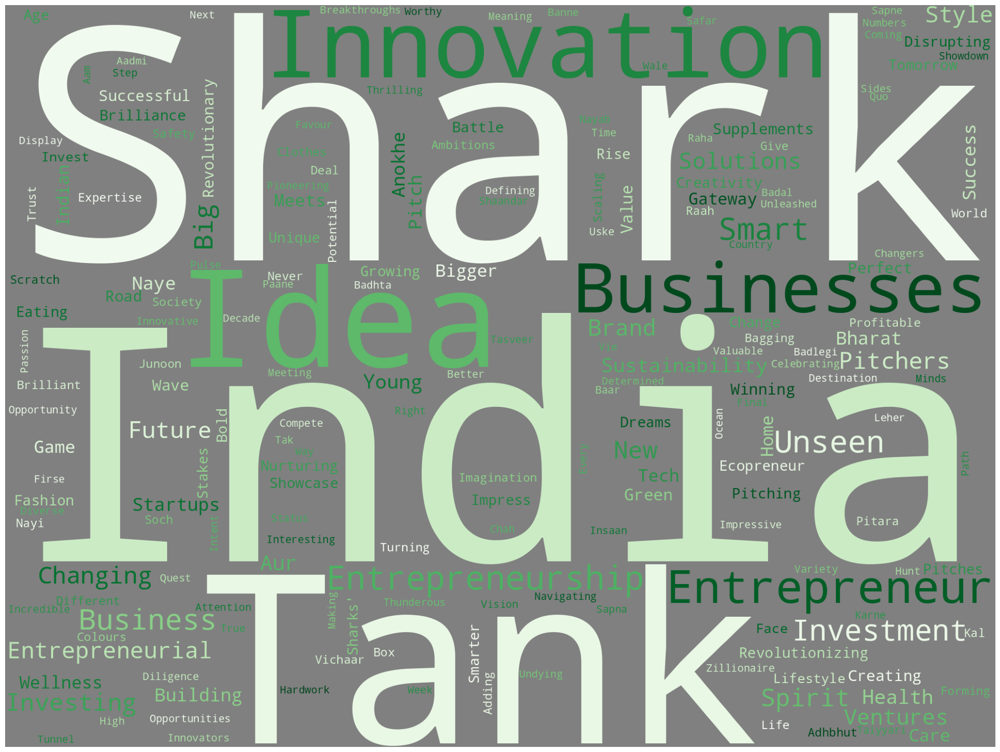

In [58]:
text = " Shark Tank India ".join(cat for cat in df.loc[df['Episode Title'].notnull()]['Episode Title'])
stop_words = list(STOPWORDS) + ["Ka", "Ki", "Ke", "Ko", "Se", "Hai", "Ek"]
wordcloud = WordCloud(width=2000, height=1500, stopwords=stop_words, background_color='Grey', colormap='Greens', collocations=False, random_state=2025).generate(text)
plt.figure(figsize=(25,20))
plt.imshow(wordcloud)
plt.axis("off")
plt.show()

# All seasons of SHARK TANK INDIA was broadcasted in SonyLiv OTT and Sony TV

In [59]:
print(df['Season Number'].max(), "Total seasons in Indian SharkTank \n")
print(df['Pitch Number'].max(), "Startups came for pitching \n")

4 Total seasons in Indian SharkTank 

634 Startups came for pitching 



In [60]:
shark_tank_season1 = df.loc[df['Season Number']==1]
shark_tank_season1_without_unseen = df.loc[(df['Season Number']==1) & (df['Episode Number']!=0)]
shark_tank_season2 = df.loc[df['Season Number']==2]
shark_tank_season3 = df.loc[(df['Season Number']==3) | (df['Season Number'].isnull())]
shark_tank_season4 = df.loc[df['Season Number']==4]

In [61]:
print("In Season 1, in", shark_tank_season1['Episode Number'].max(), "episodes, there were", shark_tank_season1.loc[shark_tank_season1['Episode Number']!=0]['Startup Name'].count(), "actual pitches and", shark_tank_season1.loc[shark_tank_season1['Episode Number']==0]['Startup Name'].count(),"unseen pitches\n")
print("In Season 2, in", shark_tank_season2['Episode Number'].max(), "episodes, there were", shark_tank_season2.loc[shark_tank_season2['Episode Number']!=0]['Startup Name'].count(), "actual pitches and", shark_tank_season2.loc[shark_tank_season2['Episode Number']==0]['Startup Name'].count(),"unseen pitch\n")
print("In Season 3, in", shark_tank_season3['Episode Number'].max(), "episodes, there were", shark_tank_season3.loc[shark_tank_season3['Episode Number']!=0]['Startup Name'].count(), "actual pitches\n")
print("In Season 4, in", shark_tank_season4['Episode Number'].max(), "episodes, there were", shark_tank_season4.loc[shark_tank_season4['Episode Number']!=0]['Startup Name'].count(), "actual pitches\n")

In Season 1, in 36 episodes, there were 122 actual pitches and 30 unseen pitches

In Season 2, in 51 episodes, there were 168 actual pitches and 1 unseen pitch

In Season 3, in 52 episodes, there were 157 actual pitches

In Season 4, in 52 episodes, there were 156 actual pitches



# Pitch Statistics

Season Number    1   2   3   4
Episode Number  36  51  52  52


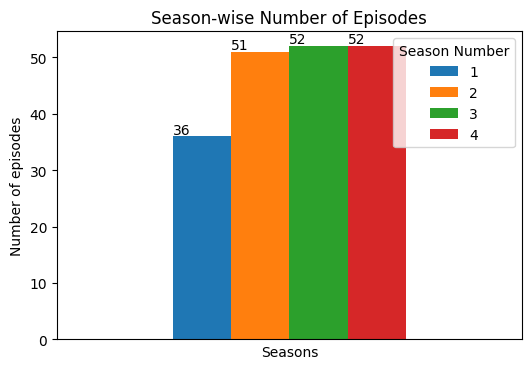

In [62]:
# Season-wise number of episodes
tmp = pd.pivot_table(df, values='Episode Number', columns='Season Number', aggfunc='max')
print(tmp)
ax = tmp.plot.bar(figsize=(6,4), title="Season-wise Number of Episodes")
plt.xlabel("Seasons")
plt.ylabel("Number of episodes")
plt.xticks([])
for t in ax.patches:
    if (np.isnan(float(t.get_height()))):
        ax.annotate(0, (t.get_x(), 0))
    else:
        ax.annotate(str(format(int(t.get_height()), ',d')), (t.get_x(), t.get_height()*1.01))

In [63]:
# Season-wise number of pitches
tmp = df['Season Number'].value_counts().sort_values()
fig = px.bar(tmp, x=tmp.values, title="<b> Season-wise number of pitches</b>", template='ggplot2', text=tmp, width=520, height=400)
fig.update_yaxes(tickvals=list(range(6)))
fig.update_xaxes(visible=False)
fig.show(renderer="iframe")

In [105]:
import pandas as pd
import plotly.express as px

# Mark pitches as funded if Total Deal Amount > 0
df['Got Funded'] = df['Total Deal Amount'] > 0

# Count funded pitches per season
funded_pitches = df[df['Got Funded']]
tmp = funded_pitches['Season Number'].value_counts().sort_index()
tmp = tmp.reset_index()
tmp.columns = ['Season', 'Funded Pitches']

# Convert Season to string for clean x-axis
tmp['Season'] = tmp['Season'].astype(str)

# Plot
fig = px.bar(
    tmp,
    x='Season',
    y='Funded Pitches',
    text='Funded Pitches',
    title='<b>Season-wise Number of Funded Pitches</b>',
    template='plotly_white',
)

fig.update_traces(textposition='outside')
fig.update_layout(
    xaxis_title='Season',
    yaxis_title='Number of Funded Pitches',
    title_x=0.5,
    bargap=0.3
)

fig.show(renderer='iframe')


Among all seasons, Season 2 saw the most pitches getting funded, whereas Season 1 had the lowest funding activity.

In [65]:
print("Number of pitches per episode was:\n")
print(df.loc[df['Episode Number']!=0][['Season Number','Episode Number']].value_counts().sort_values(ascending=True).unique())


Number of pitches per episode was:

[2 3 4]


In [101]:
# Types of industries, came for investment, in current/latest season (4th season)
tmp = shark_tank_season4['Industry'].value_counts().sort_values(ascending=True)
fig = px.bar(tmp, x=tmp.values, title="<b> Indian Shark Tank in 4th season - Industry wise startups</b>", template='simple_white', text=tmp, width=630, height=600)
fig.update_yaxes(title_text="")
fig.update_xaxes(visible=False)
fig.show(renderer="iframe")

In [106]:
#Pitches Analysis
total_pitches = len(df)
offers_received = df['Received Offer'].sum()
offers_accepted = df['Accepted Offer'].sum()

print(f"Total Pitches: {total_pitches}")
print(f"Received Offers: {offers_received}")
print(f"Accepted Offers: {offers_accepted}")



Total Pitches: 402
Received Offers: 271
Accepted Offers: 227.0


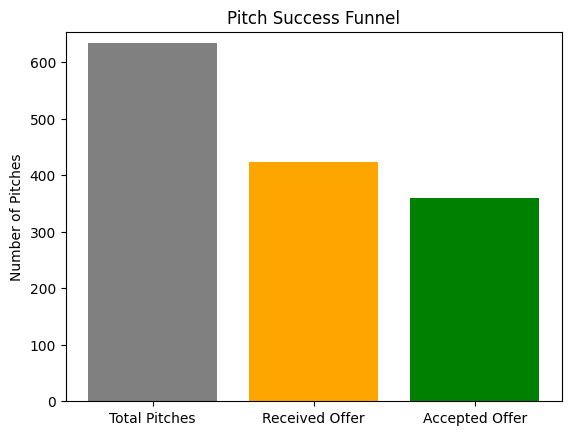

In [67]:
import matplotlib.pyplot as plt

labels = ['Total Pitches', 'Received Offer', 'Accepted Offer']
values = [total_pitches, offers_received, offers_accepted]

plt.bar(labels, values, color=['gray', 'orange', 'green'])
plt.title("Pitch Success Funnel")
plt.ylabel("Number of Pitches")
plt.ylim(0, max(values) + 20)
plt.show()


In [68]:
import pandas as pd

season_summary = df.groupby('Season Number').agg(
    total_pitches=('Startup Name', 'count'),
    received_offers=('Received Offer', 'sum'),
    accepted_offers=('Accepted Offer', 'sum')
).reset_index()

season_summary['acceptance_rate'] = (season_summary['accepted_offers'] / season_summary['received_offers']).fillna(0)
season_summary['rejection_rate'] = 1 - season_summary['acceptance_rate']

season_summary['acceptance_rate'] = season_summary['acceptance_rate'].round(2)
season_summary['rejection_rate'] = season_summary['rejection_rate'].round(2)

season_summary


,Season Number,total_pitches,received_offers,accepted_offers,acceptance_rate,rejection_rate
0,1,152,96,70.0,0.73,0.27
1,2,169,121,106.0,0.88,0.12
2,3,157,104,92.0,0.88,0.12
3,4,156,102,92.0,0.90,0.10


In [107]:
import plotly.graph_objects as go

fig = go.Figure()

# Add Acceptance Rate bar (light green)
fig.add_trace(go.Bar(
    x=season_summary['Season Number'].astype(str),
    y=season_summary['acceptance_rate'],
    name='Acceptance Rate',
    marker_color='lightgreen',
    text=season_summary['acceptance_rate'].apply(lambda x: f"{x:.0%}"),
    textposition='outside'
))

# Add Rejection Rate bar (red)
fig.add_trace(go.Bar(
    x=season_summary['Season Number'].astype(str),
    y=season_summary['rejection_rate'],
    name='Rejection Rate',
    marker_color='red',
    text=season_summary['rejection_rate'].apply(lambda x: f"{x:.0%}"),
    textposition='outside'
))

# Update layout
fig.update_layout(
    title='<b>Acceptance vs Rejection Rate by Season</b>',
    xaxis_title='Season',
    yaxis_title='Rate',
    barmode='group',
    template='plotly_white',
    title_x=0.5,
    yaxis=dict(tickformat=".0%"),
    uniformtext_minsize=8,
    uniformtext_mode='hide'
)

fig.show(renderer='iframe')



Acceptance rates have increased consistently across seasons — from 73% in Season 1 to 90% in Season 4.

This suggests a growing openness among sharks to invest in a broader range of startups or an improvement in the quality of pitches over time.

In [109]:
# All seasons averages
pivot = pd.pivot_table(df, values=['Original Ask Amount','Total Deal Amount','Valuation Requested','Deal Valuation','Original Offered Equity','Total Deal Equity'], columns='Season Number', aggfunc=np.mean, sort=False)
pivot.style.format('{:.0f}')


/var/folders/1v/g6bcxzl16s587g__qbw3d0z00000gp/T/ipykernel_55717/1488082707.py:2: FutureWarning:

The provided callable <function mean at 0x108333880> is currently using DataFrameGroupBy.mean. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "mean" instead.



Season Number,1,2,3,4
Original Ask Amount,66,80,95,85
Total Deal Amount,26,47,45,58
Valuation Requested,3487,6445,5363,5558
Deal Valuation,347,1609,2043,1889
Original Offered Equity,5,3,3,3
Total Deal Equity,8,4,3,3


# Presenter Demographics

In [70]:
import plotly.express as px

# Categorize pitch type
df['Pitch Type'] = df.apply(
    lambda row: 'Couple' if row['Couple Presenters'] > 0 else 
                ('Solo' if row['Number of Presenters'] == 1 else 'Group'), axis=1
)

pitch_type_counts = df['Pitch Type'].value_counts().reset_index()
pitch_type_counts.columns = ['Pitch Type', 'Count']

fig = px.pie(
    pitch_type_counts, 
    names='Pitch Type', 
    values='Count', 
    title='<b>Distribution of Pitch Types</b>',
    color_discrete_sequence=px.colors.sequential.RdBu
)
fig.update_traces(textposition='inside', textinfo='percent+label')
fig.show(renderer='iframe')


In [104]:
gender_data = {
    'Male': df['Male Presenters'].sum(),
    'Female': df['Female Presenters'].sum(),
    'Transgender': df['Transgender Presenters'].sum()
}
gender_df = pd.DataFrame(gender_data.items(), columns=['Gender', 'Count'])

fig = px.pie(
    gender_df, 
    names='Gender', 
    values='Count', 
    title='<b>Gender Breakdown of Presenters</b>',
    color_discrete_sequence=['lightblue', 'pink', 'purple']
)
fig.update_traces(textposition='inside', textinfo='percent+label')
fig.show(renderer='iframe')


While male entrepreneurs dominate the pitch floor, it's encouraging to see nearly 30% representation by female founders, reflecting growing diversity.
However, transgender representation remains minimal, highlighting an opportunity for greater inclusivity in future seasons.

Pitchers Average Age
Middle    475
Young     153
Old         6
Name: count, dtype: int64 

Pitchers Average Age
Middle    75%
Young     24%
Old        1%
Name: proportion, dtype: object 



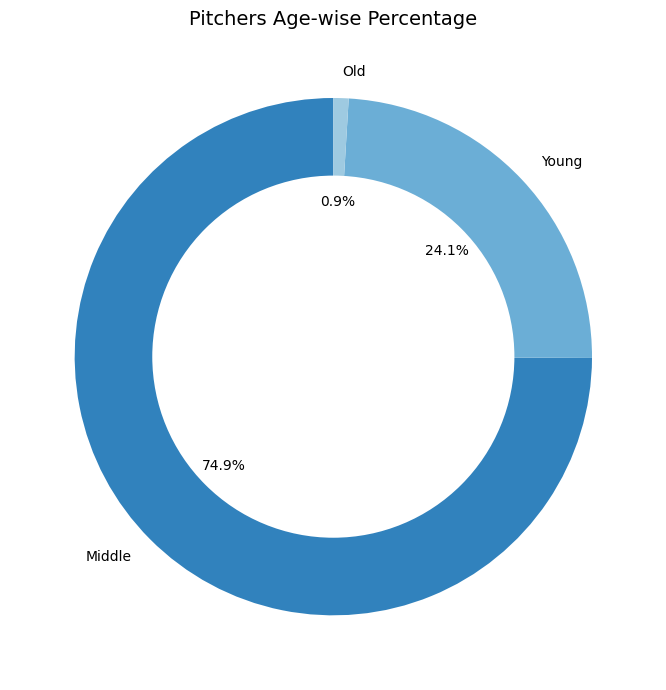

In [72]:
import matplotlib.pyplot as plt

# Count and percentage
print(df['Pitchers Average Age'].value_counts(), "\n")
print(round(df['Pitchers Average Age'].value_counts(normalize=True)*100).astype(str).str.replace('.0', '%', regex=False), "\n")

# Data for plotting
age_counts = df["Pitchers Average Age"].value_counts()

# Plot
fig, ax = plt.subplots(figsize=(7, 7))
wedges, texts, autotexts = ax.pie(
    age_counts,
    labels=age_counts.index,
    autopct='%.1f%%',
    startangle=90,
    textprops=dict(color="black"),
    colors=plt.cm.tab20c.colors
)

# Draw white circle to make it a doughnut
centre_circle = plt.Circle((0, 0), 0.70, fc='white')
fig.gca().add_artist(centre_circle)

plt.title("Pitchers Age-wise Percentage", fontsize=14)
plt.tight_layout()
plt.show()


In [102]:
import plotly.express as px

# Prepare Top 10 Cities
top_cities = df['Pitchers City'].value_counts().head(10).reset_index()
top_cities.columns = ['City', 'Count']

# Plot with unique colors per city
fig = px.bar(
    top_cities,
    x='City',
    y='Count',
    color='City',  # Different color per city
    title='<b>Top 10 Pitcher Cities</b>',
    text='Count',
    template='plotly_white'
)

fig.update_traces(textposition='outside')
fig.update_layout(
    title_x=0.5,
    showlegend=False  # Hide legend if not needed
)

fig.show(renderer='iframe')



Mumbai, Delhi, and Bangalore emerge as the leading startup hubs, consistently featuring among the top 10 cities with the highest number of entrepreneurs pitching on Shark Tank India. 

# Business Characteristics

In [74]:
import pandas as pd
import plotly.express as px

# Group by industry and calculate success rate
industry_success = df.groupby('Industry').agg(
    Total_Pitches=('Startup Name', 'count'),
    Funded_Pitches=('Got Funded', 'sum')
).sort_values(by='Total_Pitches', ascending=False).head(10)

industry_success['Success_Rate'] = round((industry_success['Funded_Pitches'] / industry_success['Total_Pitches']) * 100, 1)

# Plot using plotly
fig = px.bar(
    industry_success.reset_index(),
    x='Industry',
    y='Success_Rate',
    text='Success_Rate',
    title='<b>Top 10 Industries and Their Success Rates</b>',
    color='Industry',
    template='plotly_white'
)

fig.update_traces(textposition='outside')
fig.update_layout(showlegend=False, title_x=0.5)
fig.show()


The Fitness, Sports & Outdoor sector leads with a remarkable 78.9% success rate, indicating strong investor interest. Meanwhile, traditional sectors like Food & Beverage and Beauty & Fashion still perform well, but face stiffer competition.

In [103]:
import pandas as pd
import plotly.express as px

# Filter rows where margins are not null
df_filtered = df.dropna(subset=['Gross Margin', 'Net Margin'])

# Plot using plotly for Gross Margin vs Net Margin by Industry
fig = px.scatter(
    df_filtered,
    x='Gross Margin',
    y='Net Margin',
    color='Industry',
    title="<b>Gross Margin vs Net Margin by Industry</b>",
    template='plotly_white',
    labels={'Gross Margin': 'Gross Margin (%)', 'Net Margin': 'Net Margin (%)'}
)

fig.update_layout(title_x=0.5)
fig.show()


In [112]:
import pandas as pd
import plotly.express as px

# Ensure 'Started in' contains valid numeric values
df['Started in'] = pd.to_numeric(df['Started in'], errors='coerce')

# Filter out rows where 'Started in' is before 2017
df = df[df['Started in'] >= 2017]

# Clean the 'Season Number' to ensure it's an integer
df['Season Number'] = df['Season Number'].apply(lambda x: int(x) if pd.notna(x) else None)

# Group by 'Started in' (the year the business was started) and 'Season Number' to analyze deal success rate
started_vs_season = df.groupby(['Started in', 'Season Number']).agg(
    Total_Pitches=('Startup Name', 'count'),
    Funded_Pitches=('Got Funded', 'sum')
).reset_index()

# Calculate success rate
started_vs_season['Success_Rate'] = round((started_vs_season['Funded_Pitches'] / started_vs_season['Total_Pitches']) * 100, 1)

# Plot using scatter plot
fig = px.scatter(
    started_vs_season,
    x='Started in',
    y='Success_Rate',
    color='Season Number',
    size='Total_Pitches',
    title="<b>Started In vs Season Year: Are Newer Businesses More Likely to Get a Deal?</b>",
    template='plotly_white',
    labels={'Started in': 'Year Started', 'Success_Rate': 'Success Rate (%)'},
    hover_data=['Total_Pitches', 'Funded_Pitches']  
)

fig.update_layout(
    title_x=0.5,
    xaxis_title="Year Started",
    yaxis_title="Success Rate (%)",
    xaxis=dict(tickmode='linear', tick0=min(started_vs_season['Started in']), dtick=1),  # Set ticks for years
    coloraxis_showscale=False
)

fig.update_xaxes(showgrid=True) 
fig.update_yaxes(showgrid=True)  

fig.show()


There’s no clear evidence that newer startups are significantly more likely to get a deal. 

# Financial Analysis

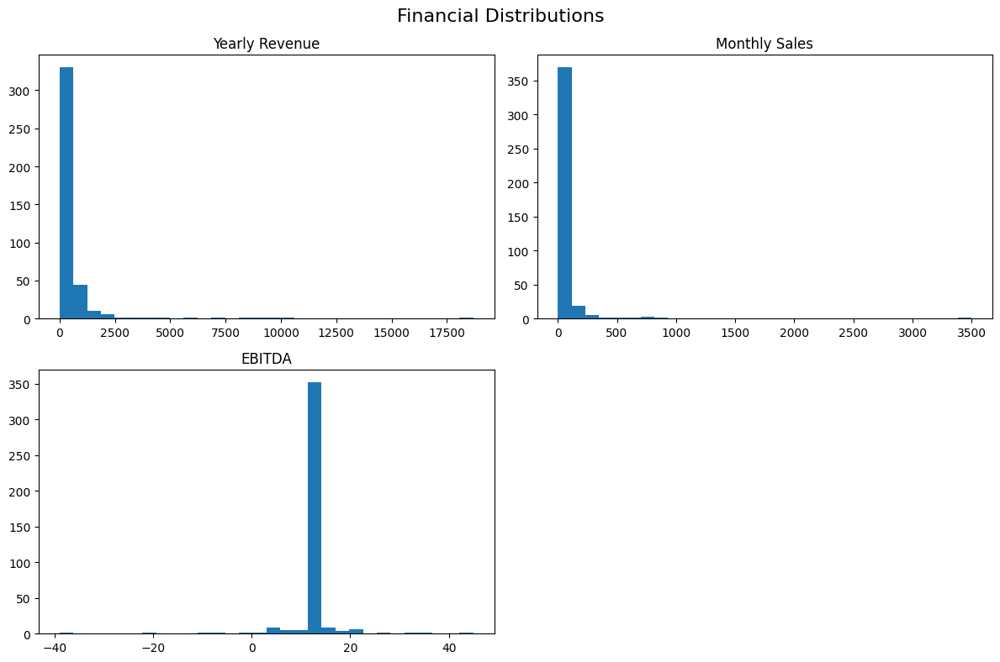

In [113]:
# Drop NaNs for distribution plot
df_dist = df[['Yearly Revenue', 'Monthly Sales', 'EBITDA', 'Cash Burn']].dropna(how='all')

df_dist.hist(bins=30, figsize=(12, 8), grid=False, color='#1f77b4')
plt.suptitle("Financial Distributions", fontsize=16)
plt.tight_layout()
plt.show()


1. Yearly Revenue
Observation: Most startups have yearly revenues clustered at the lower end (0–2000), with a steep drop-off as revenue increases.

Interpretation: A large majority of startups have relatively low annual revenues, indicating early-stage or small-scale operations. A few outliers report very high revenue (up to 18,000+), but these are rare.

2. Monthly Sales
Observation: Similarly skewed to the left — most startups report monthly sales below ₹500, with only a few going above ₹1000.

Interpretation: Like yearly revenue, this shows most startups are in early revenue stages, with limited monthly income. A handful of high-performing startups skew the scale.

3. EBITDA (Earnings Before Interest, Taxes, Depreciation, and Amortization)
Observation: A dense cluster near a certain positive EBITDA value (likely around ₹15–20), but with long tails in both directions, including negative values.

Interpretation:

The positive mode shows that many startups are aiming for or reporting small profits.

The left tail shows several startups are operating at a loss.

A few outliers also report high EBITDA.



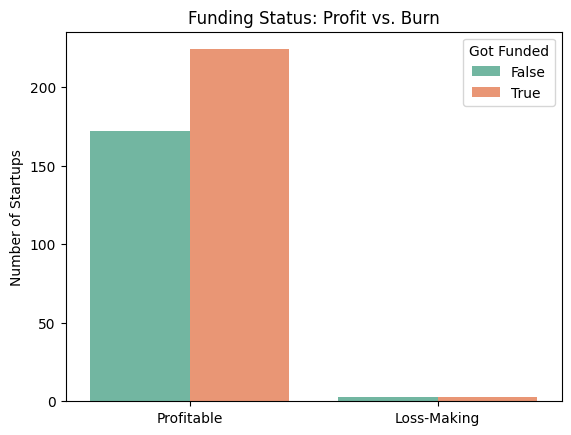

In [78]:
df_burn = df[['Cash Burn', 'EBITDA', 'Got Funded']].dropna()

# Classify as 'Profitable' or 'Burning Cash'
df_burn['Status'] = df_burn.apply(lambda x: 'Profitable' if x['EBITDA'] > 0 else 'Loss-Making', axis=1)

sns.countplot(data=df_burn, x='Status', hue='Got Funded', palette='Set2')
plt.title('Funding Status: Profit vs. Burn')
plt.xlabel('')
plt.ylabel('Number of Startups')
plt.legend(title='Got Funded')
plt.show()


Startups that are already profitable have a substantially higher chance of receiving funding.

In [79]:
df_val = df[['Valuation Requested', 'Deal Valuation']].dropna()

fig = px.scatter(
    df_val,
    x='Valuation Requested',
    y='Deal Valuation',
    title='Requested vs. Actual Deal Valuation',
    trendline='ols',
    labels={'Valuation Requested': 'Valuation Asked (in Cr)', 'Deal Valuation': 'Final Deal Valuation (in Cr)'},
    template='plotly_white',
    color_discrete_sequence=['#17becf']
)

fig.update_layout(title_x=0.5)
fig.show()


# Shark Participation and Investment Trends

In [121]:
sharks_names = []

for col in df.columns[41:-13:3]: 
    shark = col.split(maxsplit=1)[0]  
    sharks_names.append(shark)

print(len(sharks_names), "sharks participated.\n")
print("Following are the names:\n")
print(sharks_names)


8 sharks participated.

Following are the names:

['Namita', 'Vineeta', 'Anupam', 'Aman', 'Peyush', 'Ritesh', 'Amit', 'Guest']


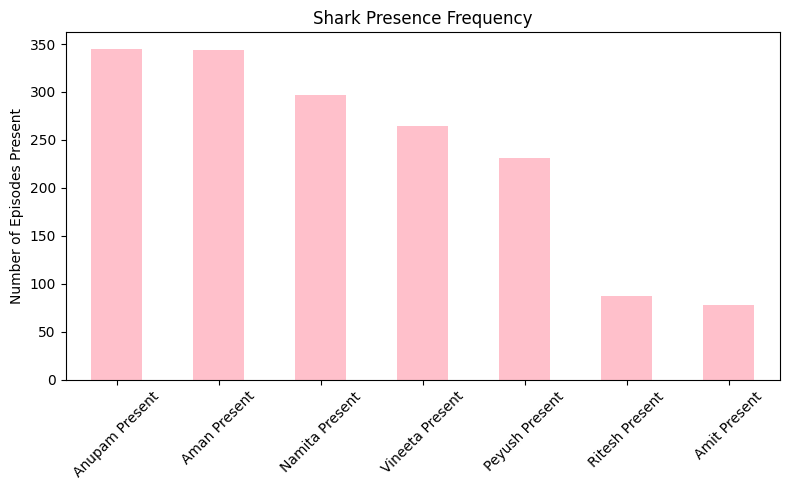

In [80]:
import matplotlib.pyplot as plt

sharks = ['Namita Present', 'Vineeta Present', 'Anupam Present', 'Aman Present', 'Peyush Present', 'Ritesh Present', 'Amit Present']

presence_counts = df[sharks].sum().sort_values(ascending=False)

plt.figure(figsize=(8, 5))
presence_counts.plot(kind='bar', color='pink')
plt.title("Shark Presence Frequency")
plt.ylabel("Number of Episodes Present")
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


Anupam and Aman are the most frequently present sharks, each appearing in nearly all episodes, highlighting their consistent participation across seasons.

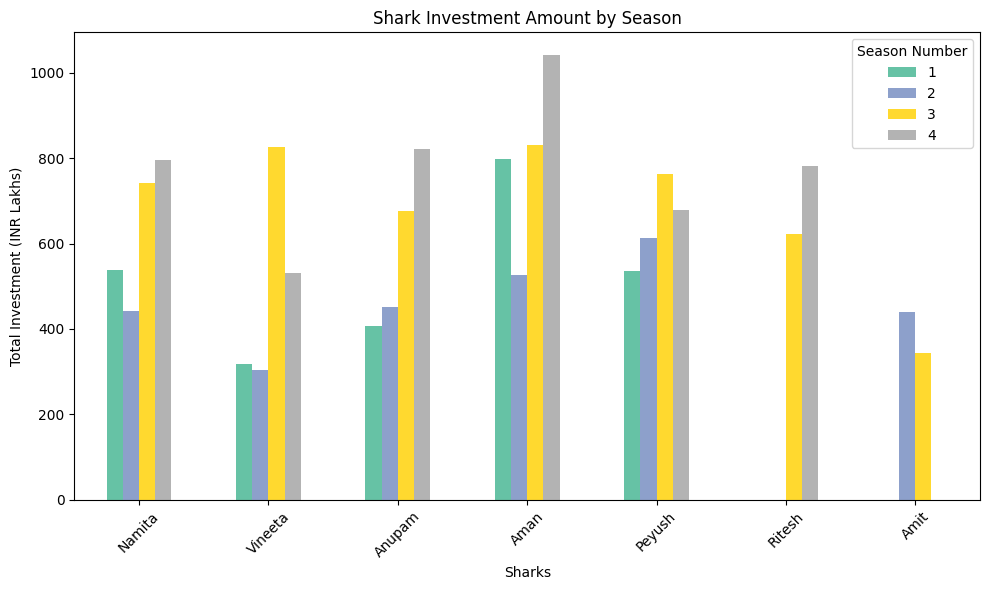

In [92]:
shark_cols = {
    'Namita': 'Namita Investment Amount',
    'Vineeta': 'Vineeta Investment Amount',
    'Anupam': 'Anupam Investment Amount',
    'Aman': 'Aman Investment Amount',
    'Peyush': 'Peyush Investment Amount',
    'Ritesh': 'Ritesh Investment Amount',
    'Amit': 'Amit Investment Amount'
}

season_wise = df.groupby('Season Number')[[col for col in shark_cols.values()]].sum()
season_wise.columns = shark_cols.keys()
season_wise = season_wise.T

season_wise.plot(kind='bar', figsize=(10, 6), title="Shark Investment Amount by Season", colormap='Set2')
plt.ylabel("Total Investment (INR Lakhs)")
plt.xlabel("Sharks")
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


## INSIGHTS BY SHARK

## Aman Gupta

Consistently the top investor across all seasons.

His investment peaked in Season 4, indicating growing confidence or presence.

## Anupam Mittal

Steady rise from Season 1 to Season 4.

Significantly high jump in Season 4, showing increased involvement.

## Namita Thapar

Shows consistent and growing investment across seasons.

Season 4 marks her highest contribution, after a sharp rise since Season 2.

## Peyush Bansal

Gradual increase till Season 3.

Slight dip or plateau in Season 4.

## Vineeta Singh

Moderate and fairly stable investor.

Season 3 was her peak investment, with a small decline in Season 4.

## Ritesh Agarwal

Appears only in Season 3 and 4.

Strong presence in both, especially Season 4.

## Amit Jain

Participated only in Seasons 2 and 3.

Lesser investment compared to others, possibly a guest or late-entrant.

## Overall Analysis
Season 4 had the highest total investments overall, marking it as a high-engagement season.












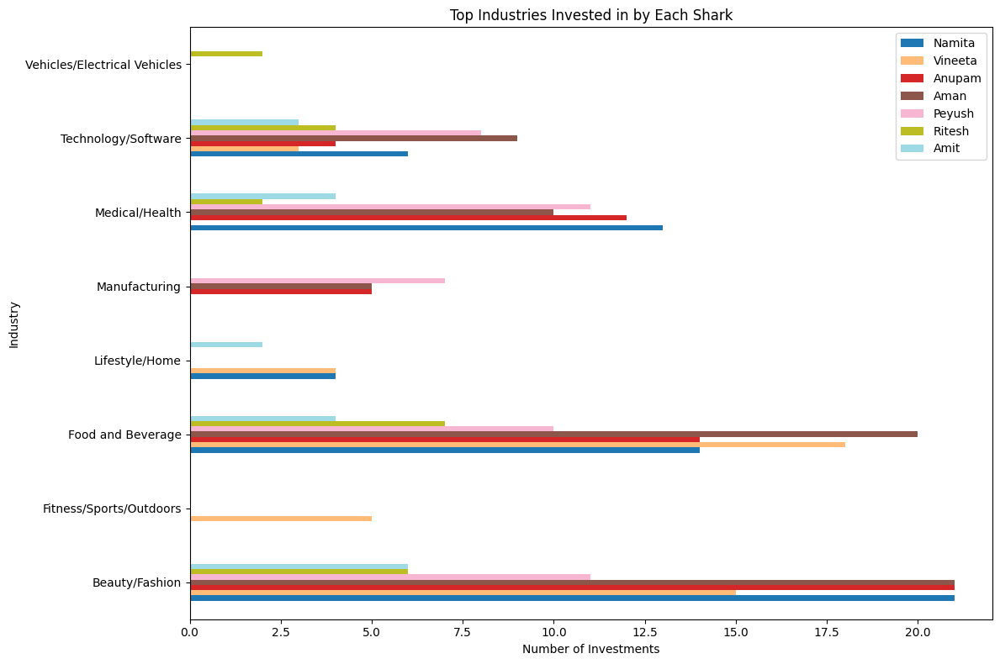

In [82]:
import matplotlib.pyplot as plt

# Shark columns and corresponding names
shark_invest_cols = {
    'Namita': 'Namita Investment Amount',
    'Vineeta': 'Vineeta Investment Amount',
    'Anupam': 'Anupam Investment Amount',
    'Aman': 'Aman Investment Amount',
    'Peyush': 'Peyush Investment Amount',
    'Ritesh': 'Ritesh Investment Amount',
    'Amit': 'Amit Investment Amount'
}

# Dictionary to store industry investment count per shark
shark_industry = {}

for shark, col in shark_invest_cols.items():
    invested_df = df[df[col] > 0]  # Filter where this shark invested
    top_industries = invested_df['Industry'].value_counts().head(5)
    shark_industry[shark] = top_industries

# Convert to a single DataFrame for plotting
shark_industry_df = pd.DataFrame(shark_industry).fillna(0).astype(int)

# Plotting (horizontal)
shark_industry_df.plot(kind='barh', figsize=(12, 8), colormap='tab20', title='Top Industries Invested in by Each Shark')
plt.xlabel("Number of Investments")
plt.ylabel("Industry")
plt.tight_layout()
plt.show()



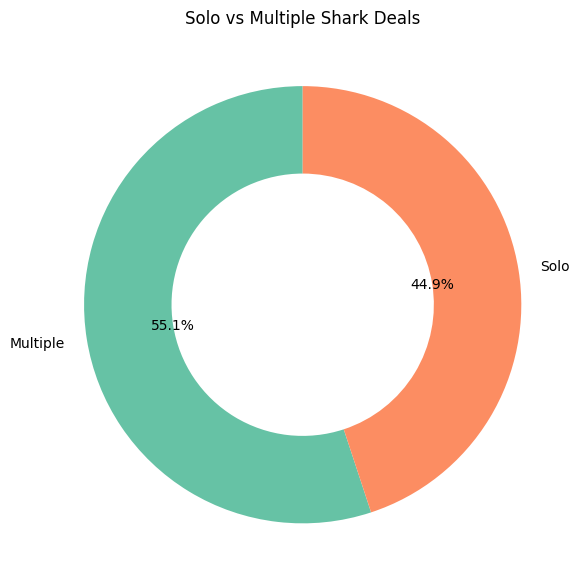

In [93]:
# Filter funded deals
funded_df = df[df['Total Deal Amount'] > 0].copy()

# Count number of sharks involved in each deal
funded_df['Sharks Involved'] = (
    (funded_df['Namita Investment Amount'] > 0).astype(int) +
    (funded_df['Vineeta Investment Amount'] > 0).astype(int) +
    (funded_df['Anupam Investment Amount'] > 0).astype(int) +
    (funded_df['Aman Investment Amount'] > 0).astype(int) +
    (funded_df['Peyush Investment Amount'] > 0).astype(int) +
    (funded_df['Ritesh Investment Amount'] > 0).astype(int) +
    (funded_df['Amit Investment Amount'] > 0).astype(int)
)

# Classify deals
funded_df['Deal Type'] = funded_df['Sharks Involved'].apply(lambda x: 'Solo' if x == 1 else 'Multiple')

# Count solo vs multiple deals
deal_counts = funded_df['Deal Type'].value_counts()

# Plot
import matplotlib.pyplot as plt

plt.figure(figsize=(6, 6))
colors = ['#66c2a5', '#fc8d62']
deal_counts.plot(kind='pie', autopct='%1.1f%%', colors=colors, startangle=90, wedgeprops=dict(width=0.4))
plt.title("Solo vs Multiple Shark Deals")
plt.ylabel('')
plt.tight_layout()
plt.show()


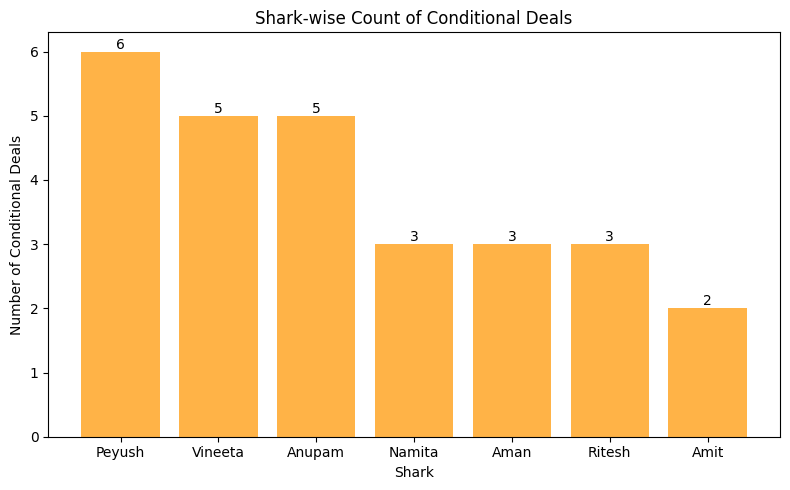

In [85]:
import pandas as pd
import matplotlib.pyplot as plt

# Filter only funded deals with conditions
conditional_deals = df[(df['Deal Has Conditions'] == 'yes') & (df['Total Deal Amount'] > 0)]

# Total number of conditional deals
total_conditional = len(conditional_deals)

# Shark-wise conditional deal counts
sharks = ['Namita', 'Vineeta', 'Anupam', 'Aman', 'Peyush', 'Ritesh', 'Amit']

shark_cond_counts = {}

for shark in sharks:
    shark_col = f"{shark} Investment Amount"
    count = conditional_deals[conditional_deals[shark_col] > 0].shape[0]
    shark_cond_counts[shark] = count

# Convert to DataFrame for plotting
shark_cond_df = pd.DataFrame.from_dict(shark_cond_counts, orient='index', columns=['Conditional Deals'])
shark_cond_df = shark_cond_df.sort_values('Conditional Deals', ascending=False)

# Plot
plt.figure(figsize=(8, 5))
bars = plt.bar(shark_cond_df.index, shark_cond_df['Conditional Deals'], color='#ffb347')
plt.title("Shark-wise Count of Conditional Deals")
plt.xlabel("Shark")
plt.ylabel("Number of Conditional Deals")

# Add count annotations
for bar in bars:
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2, height, int(height), ha='center', va='bottom')

plt.tight_layout()
plt.show()


# Deal Outcomes and Patterns

/var/folders/1v/g6bcxzl16s587g__qbw3d0z00000gp/T/ipykernel_55717/1345446805.py:18: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.




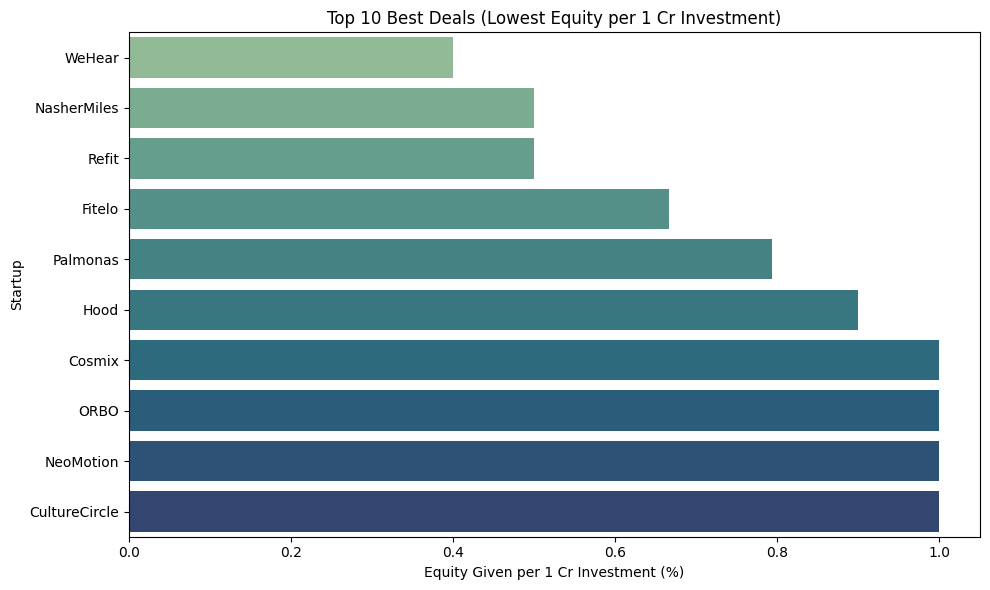

In [86]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Make sure these columns exist and are numeric
df['Total Deal Amount'] = pd.to_numeric(df['Total Deal Amount'], errors='coerce')
df['Total Deal Equity'] = pd.to_numeric(df['Total Deal Equity'], errors='coerce')

# Create metric: equity given per ₹1 Cr investment
df['Equity per Crore'] = df['Total Deal Equity'] / (df['Total Deal Amount'] / 100)

# Filter out invalid values
best_deals = df[(df['Total Deal Amount'] > 0) & (df['Total Deal Equity'] > 0)]
best_deals = best_deals.sort_values(by='Equity per Crore').head(10)

# Plotting
plt.figure(figsize=(10, 6))
sns.barplot(
    data=best_deals,
    x='Equity per Crore',
    y='Startup Name',
    palette='crest'
)
plt.title('Top 10 Best Deals (Lowest Equity per 1 Cr Investment)')
plt.xlabel('Equity Given per 1 Cr Investment (%)')
plt.ylabel('Startup')
plt.tight_layout()
plt.show()


his bar chart visualizes the Top 10 startup deals from Shark Tank India 
that offered the **least amount of equity per ₹1 crore investment**, indicating 
the **best deals from an investor's point of view**

Key Observations:
1. **WeHear** gave away the least equity (~0.36%) for ₹1 Cr, indicating the highest valuation among the deals.
2. **NasherMiles** and **Refit** follow closely, also showing high investor-favorable terms.
3. Startups like **Fitelo**, **Palmonas**, and **Hood** gave away slightly more but still remained within a favorable range.
4. The bottom three startups — **Cosmix**, **ORBO**, and **NeoMotion** — gave away around 1% equity, still making the list of top 10 favorable deals.


/var/folders/1v/g6bcxzl16s587g__qbw3d0z00000gp/T/ipykernel_55717/520255084.py:2: FutureWarning:

The provided callable <function mean at 0x108333880> is currently using DataFrameGroupBy.mean. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "mean" instead.



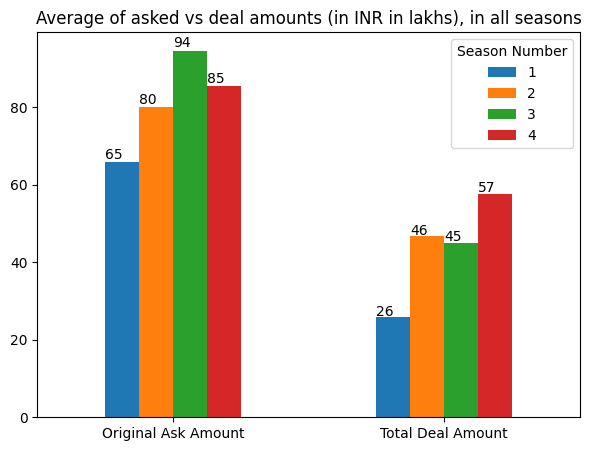

In [87]:
# All seasons average of offered/deal amounts
ax = pd.pivot_table(df, values=['Original Ask Amount','Total Deal Amount'], columns='Season Number', aggfunc=np.mean, sort=False).plot.bar(figsize=(7,5), title="Average of asked vs deal amounts (in INR in lakhs), in all seasons")
plt.xticks(rotation='horizontal')
for t in ax.patches:
    if (np.isnan(float(t.get_height()))):
        ax.annotate(0, (t.get_x(), 0))
    else:
        ax.annotate(str(format(int(t.get_height()), ',d')), (t.get_x(), t.get_height()*1.01))


/var/folders/1v/g6bcxzl16s587g__qbw3d0z00000gp/T/ipykernel_55717/4157631541.py:2: FutureWarning:

The provided callable <function mean at 0x108333880> is currently using DataFrameGroupBy.mean. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "mean" instead.



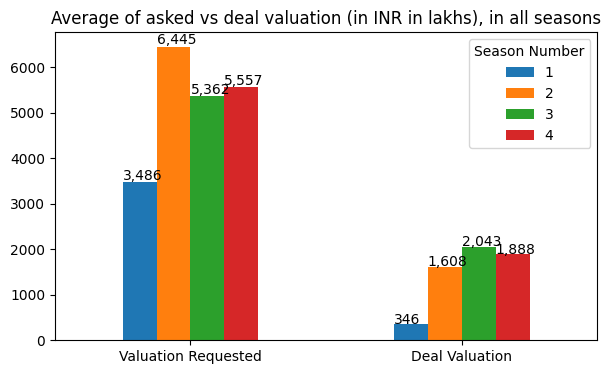

In [88]:
#All seasons average of offered/deal valuation
ax = pd.pivot_table(df, values=['Valuation Requested','Deal Valuation'], columns='Season Number', aggfunc=np.mean, sort=False).plot.bar(figsize=(7,4), title="Average of asked vs deal valuation (in INR in lakhs), in all seasons")
plt.xticks(rotation='horizontal')
for t in ax.patches:
    if (np.isnan(float(t.get_height()))):
        ax.annotate(0, (t.get_x(), 0))
    else:
        ax.annotate(str(format(int(t.get_height()), ',d')), (t.get_x(), t.get_height()*1.01))

In [89]:
# Offers rejected by pitchers/startup companies
print(df[df['Accepted Offer']==0]["Startup Name"].count())
df.loc[df['Accepted Offer']==0, ["Season Number","Startup Name","Industry","Original Ask Amount","Original Offered Equity"]]

175


,Season Number,Startup Name,Industry,Original Ask Amount,Original Offered Equity
6,1,qZenseLabs,Food and Beverage,100.0,0.25
14,1,ShrawaniEngineers,Beauty/Fashion,20.0,10.00
17,1,Hecoll,Beauty/Fashion,100.0,1.00
19,1,Torch-it,Children/Education,75.0,1.00
21,1,LaKheerDeli,Food and Beverage,50.0,7.50
...,...,...,...,...,...
624,4,UrbanAnimal,Animal/Pets,45.0,5.00
625,4,Nooky,Lifestyle/Home,60.0,1.00
626,4,Subculture,Beauty/Fashion,50.0,7.00
627,4,Woodsmen,Liquor/Alcohol,150.0,0.50


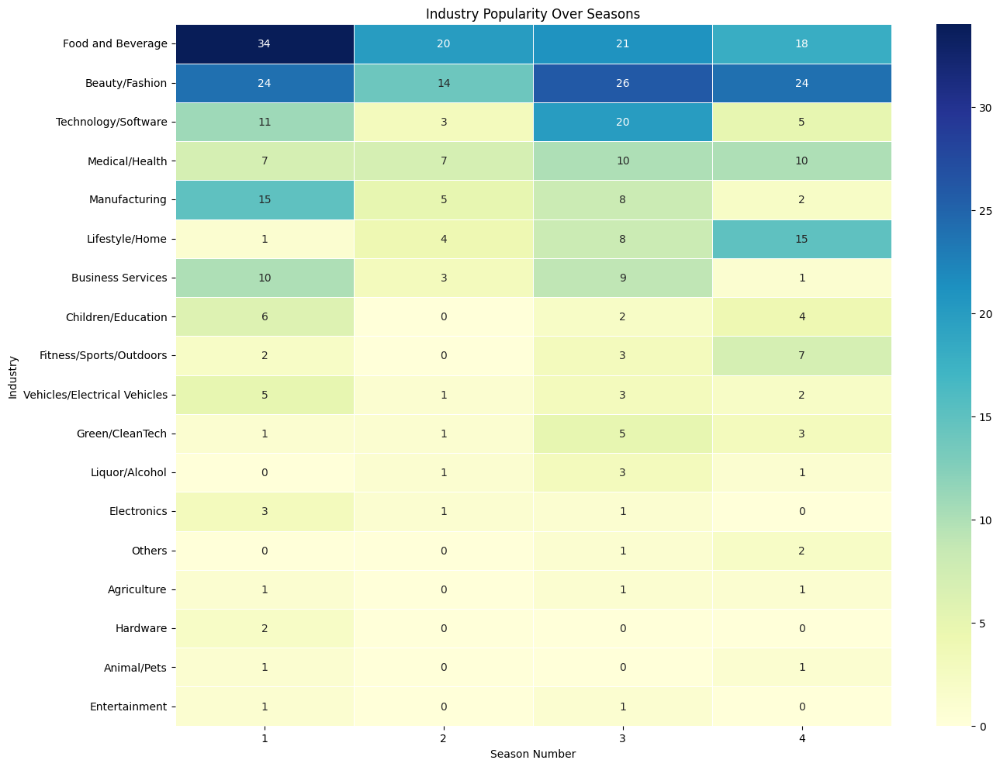

In [97]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Group by Industry and Season Number
industry_season = df.groupby(['Industry', 'Season Number']).size().unstack(fill_value=0)

# Sort industries by total pitches across seasons
industry_season = industry_season.loc[industry_season.sum(axis=1).sort_values(ascending=False).index]

# Plot heatmap
plt.figure(figsize=(14, 10))
sns.heatmap(industry_season, annot=True, fmt='d', cmap='YlGnBu', linewidths=0.5)
plt.title("Industry Popularity Over Seasons")
plt.xlabel("Season Number")
plt.ylabel("Industry")
plt.tight_layout()
plt.show()


# Insights:
The heatmap reveals an evolving startup ecosystem where traditional sectors like Food & Beverage are giving way to rising interest in tech, lifestyle, and sustainability domains. This reflects changing consumer behavior, innovation focus, and perhaps shifting shark preferences.

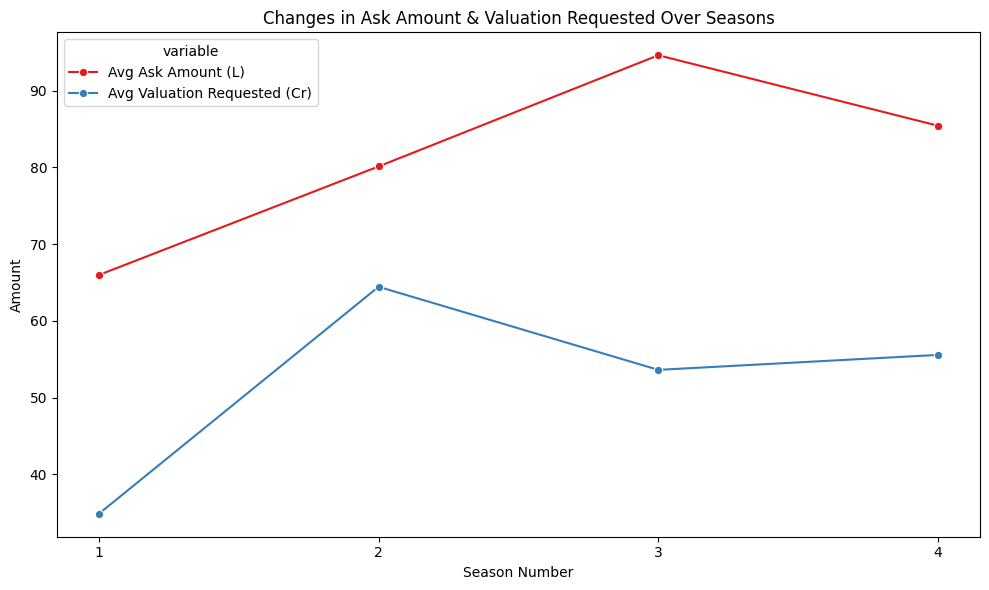

In [100]:
import matplotlib.pyplot as plt
import seaborn as sns

# Group by Season Number
valuation_trends = df.groupby('Season Number').agg({
    'Original Ask Amount': 'mean',
    'Valuation Requested': 'mean'
}).reset_index()

# Rename for clarity
valuation_trends.columns = ['Season', 'Avg Ask Amount (L)', 'Avg Valuation Requested (Cr)']

# Convert valuation to crores if needed
valuation_trends['Avg Valuation Requested (Cr)'] = valuation_trends['Avg Valuation Requested (Cr)'] / 100

# Ensure Season is integer
valuation_trends['Season'] = valuation_trends['Season'].astype(int)

# Melt for plotting
melted_valuation = valuation_trends.melt(id_vars='Season', 
                                         value_vars=['Avg Ask Amount (L)', 'Avg Valuation Requested (Cr)'])

# Plot
plt.figure(figsize=(10, 6))
sns.lineplot(data=melted_valuation, x='Season', y='value', hue='variable', marker='o', palette='Set1')
plt.title("Changes in Ask Amount & Valuation Requested Over Seasons")
plt.xlabel("Season Number")
plt.ylabel("Amount")
plt.xticks(valuation_trends['Season'].unique())
#plt.grid(True)
plt.tight_layout()
plt.show()


## Insights:
1. Startups have generally increased their funding expectations over time.
2. A divergence appears after Season 2: while ask amounts continued to rise until Season 3, valuations dropped, signaling a shift in investor sentiment or startup strategy.
3. Season 4 shows signs of more balanced behavior.


# Conclusion
This analysis of Shark Tank India reveals clear patterns behind successful startup funding. Investors tend to favor startups in rapidly growing sectors like Fitness & Sports, those with strong financial metrics, and pitches that demonstrate innovation, clarity, and team diversity. While high competition exists in traditional categories like Food & Beverage, standout businesses still secure deals by differentiating themselves. The data also highlights individual investor tendencies and underscores the role of business fundamentals like revenue, gross margin, and valuation alignment in attracting offers.

# Key insights
1. Fitness sector had the highest success rate (78.9%).

2. Food & Beauty sectors faced high competition, lower conversions.

3. Stronger financials (high margin/EBITDA) boosted funding chances.

4. Mixed/couple teams pitched more successfully.

5. Newer startups (post-2020) got funded more often.

6. Equity deals dominated over debt or hybrid offers.

7. Aman & Peyush invested widely; others had sector focus.



In [124]:
df.to_csv('Shark_tank_analysis.csv', index=False)

In [129]:
df.columns

Index(['Season Number', 'Startup Name', 'Episode Number', 'Pitch Number',
       'Season Start', 'Season End', 'Original Air Date', 'Episode Title',
       'Anchor', 'Industry', 'Business Description', 'Started in',
       'Number of Presenters', 'Male Presenters', 'Female Presenters',
       'Transgender Presenters', 'Couple Presenters', 'Pitchers Average Age',
       'Pitchers City', 'Pitchers State', 'Yearly Revenue', 'Monthly Sales',
       'Gross Margin', 'Net Margin', 'EBITDA', 'Cash Burn', 'Has Patents',
       'Part of Match off', 'Original Ask Amount', 'Original Offered Equity',
       'Valuation Requested', 'Received Offer', 'Accepted Offer',
       'Total Deal Amount', 'Total Deal Equity', 'Total Deal Debt',
       'Debt Interest', 'Deal Valuation', 'Number of Sharks in Deal',
       'Deal Has Conditions', 'Namita Investment Amount',
       'Namita Investment Equity', 'Namita Debt Amount',
       'Vineeta Investment Amount', 'Vineeta Investment Equity',
       'Vineeta Debt 